In [1]:
#Association Rules Mining
%matplotlib inline
import numpy as np
import pandas as pd 
from scipy import stats
import matplotlib.pyplot as plt 
import warnings 
import seaborn as sns
warnings.filterwarnings('ignore') 
pd.set_option('display.max_columns', None)

In [2]:
!pip install mlxtend

In [3]:
import pandas as pd
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules

df=pd.read_csv('order_products__prior.csv', encoding='latin1')
p1 = pd.read_csv('products.csv')

In [4]:
#Clean Product list
p1= p1.drop(['aisle_id','department_id'],axis=1)
p1.head()

,product_id,product_name
0,1,Chocolate Sandwich Cookies
1,2,All-Seasons Salt
2,3,Robust Golden Unsweetened Oolong Tea
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...
4,5,Green Chile Anytime Sauce


In [5]:
#Determine the most frequent purchased items & Barplot
bestseller = df['product_id'].value_counts().reset_index().head(20)
bestseller.columns = ['product_id', 'frequency_count']
bestseller.head()

,product_id,frequency_count
0,24852,472565
1,13176,379450
2,21137,264683
3,21903,241921
4,47209,213584


In [6]:
#Check the most frequent purchased item - Banana
fulldata=pd.merge(bestseller, p1, on='product_id')
fulldata.sort_values(by=['frequency_count'], ascending=False, inplace=True)
fulldata.head()

,product_id,frequency_count,product_name
0,24852,472565,Banana
1,13176,379450,Bag of Organic Bananas
2,21137,264683,Organic Strawberries
3,21903,241921,Organic Baby Spinach
4,47209,213584,Organic Hass Avocado


In [7]:
fulldata[fulldata['product_name'] == 'Spreadable Butter with Olive Oil & Sea Salt']

,product_id,frequency_count,product_name


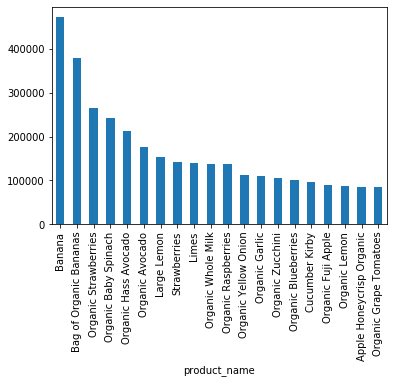

In [8]:
fulldata.set_index('product_name')['frequency_count'].plot.bar()
plt.show()

In [9]:
newdf = pd.merge(df, p1, on='product_id').drop(['add_to_cart_order','reordered'], axis=1)
newdf.head()

,order_id,product_id,product_name
0,2,33120,Organic Egg Whites
1,26,33120,Organic Egg Whites
2,120,33120,Organic Egg Whites
3,327,33120,Organic Egg Whites
4,390,33120,Organic Egg Whites


In [10]:
#Sort Order_id
newdf.sort_values(by=['order_id'], inplace=True)
newdf.head()

#looking at test_id with order less than 10000

newdf = newdf[newdf['order_id'] <= 21133]


In [11]:
#After the cleanup, we need to consolidate the items into 1 transaction per row with each product 1 hot encoded. For the sake of keeping the data set small, I’m only looking at sales for France. However, in additional code below, I will compare these results to sales from Germany. 
#Further country comparisons would be interesting to investigate.
basket = (newdf.groupby(['order_id', 'product_name'])
          .sum().unstack().reset_index().fillna(0)
          .set_index('order_id'))
basket.head(10)

product_id                               \
product_name #2 Coffee Filters #2 Cone White Coffee Filters   
order_id                                                      
2                          0.0                          0.0   
3                          0.0                          0.0   
4                          0.0                          0.0   
5                          0.0                          0.0   
6                          0.0                          0.0   
7                          0.0                          0.0   
8                          0.0                          0.0   
9                          0.0                          0.0   
10                         0.0                          0.0   
11                         0.0                          0.0   

                                              \
product_name #4 Natural Brown Coffee Filters   
order_id                                       
2                                        0.0   
3                                        0.0   
4                                        0.0   
5                                        0.0   
6                                        0.0   
7                                        0.0   
8                                        0.0   
9                                        0.0   
10                                       0.0   
11                                       0.0   

                                                     \
product_name & Go! Hazelnut Spread + Pretzel Sticks   
order_id                                              
2                                               0.0   
3                                               0.0   
4                                               0.0   
5                                               0.0   
6                                               0.0   
7                                               0.0   
8                                               0.0   
9                                               0.0   
10                                              0.0   
11                                              0.0   

                                                      \
product_name 0 Calorie Acai Raspberry Water Beverage   
order_id                                               
2                                                0.0   
3                                                0.0   
4                                                0.0   
5                                                0.0   
6                                                0.0   
7                                                0.0   
8                                                0.0   
9                                                0.0   
10                                               0.0   
11                                               0.0   

                                                              \
product_name 0 Calorie Strawberry Dragonfruit Water Beverage   
order_id                                                       
2                                                        0.0   
3                                                        0.0   
4                                                        0.0   
5                                                        0.0   
6                                                        0.0   
7                                                        0.0   
8                                                        0.0   
9                                                        0.0   
10                                                       0.0   
11                                                       0.0   

                                                                               \
product_name 0% Fat Black Cherry Greek Yogurt y 0% Fat Blueberry Greek Yogurt   
order_id                                                                        
2                                           0.0       

In [12]:
#There are a lot of zeros in the data but we also need to make sure any 
#positive values are converted to a 1 and anything less the 0 is set to 0. 
#This step will complete the one hot encoding of the data and remove the 
#postage column (since that charge is not one we wish to explore):

def encode_units(x):
    if x <= 0:
        return 0
    if x >= 1:
        return 1

basket_sets = basket.applymap(encode_units)

In [13]:
#Now that the data is structured properly, we can generate frequent item sets that have a support of at least 7% (this number was chosen so that I could get enough useful examples):
frequent_itemsets = apriori(basket_sets, min_support=0.01, use_colnames=True)

In [21]:
#The final step is to generate the rules with their corresponding support, confidence and lift:
#http://rasbt.github.io/mlxtend/user_guide/frequent_patterns/association_rules/

rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1)
rules.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,"((product_id, Bag of Organic Bananas))","((product_id, Organic Baby Spinach))",0.119702,0.073895,0.015554,0.129941,1.758454,0.006709,1.064416
1,"((product_id, Organic Baby Spinach))","((product_id, Bag of Organic Bananas))",0.073895,0.119702,0.015554,0.210490,1.758454,0.006709,1.114993
2,"((product_id, Organic Hass Avocado))","((product_id, Bag of Organic Bananas))",0.066596,0.119702,0.018776,0.281935,2.355307,0.010804,1.225931
3,"((product_id, Bag of Organic Bananas))","((product_id, Organic Hass Avocado))",0.119702,0.066596,0.018776,0.156854,2.355307,0.010804,1.107050
4,"((product_id, Organic Raspberries))","((product_id, Bag of Organic Bananas))",0.043139,0.119702,0.012937,0.299883,2.505249,0.007773,1.257359


In [15]:
rules[ (rules['lift'] >= 2) &
       (rules['confidence'] >= 0.15) ]

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
2,"((product_id, Organic Hass Avocado))","((product_id, Bag of Organic Bananas))",0.066596,0.119702,0.018776,0.281935,2.355307,0.010804,1.225931
3,"((product_id, Bag of Organic Bananas))","((product_id, Organic Hass Avocado))",0.119702,0.066596,0.018776,0.156854,2.355307,0.010804,1.107050
4,"((product_id, Organic Raspberries))","((product_id, Bag of Organic Bananas))",0.043139,0.119702,0.012937,0.299883,2.505249,0.007773,1.257359
9,"((product_id, Cucumber Kirby))","((product_id, Banana))",0.030706,0.149502,0.010772,0.350820,2.346594,0.006182,1.310111
15,"((product_id, Organic Avocado))","((product_id, Banana))",0.055472,0.149502,0.016863,0.303993,2.033374,0.008570,1.221968
18,"((product_id, Organic Fuji Apple))","((product_id, Banana))",0.027585,0.149502,0.010520,0.381387,2.551054,0.006397,1.374847
28,"((product_id, Organic Strawberries))","((product_id, Organic Baby Spinach))",0.078375,0.073895,0.012131,0.154785,2.094656,0.006340,1.095703
29,"((product_id, Organic Baby Spinach))","((product_id, Organic Strawberries))",0.073895,0.078375,0.012131,0.164169,2.094656,0.006340,1.102645
30,"((product_id, Organic Hass Avocado))","((product_id, Organic Strawberries))",0.066596,0.078375,0.011980,0.179894,2.295297,0.006761,1.123788
31,"((product_id, Organic Strawberries))","((product_id, Organic Hass Avocado))",0.078375,0.066596,0.011980,0.152858,2.295297,0.006761,1.101827


In [22]:
rules['itemset'] = rules['antecedents'].astype(str) + rules['consequents'].astype(str)

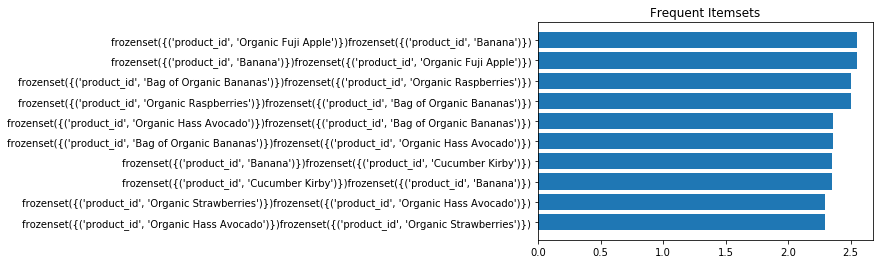

In [23]:
freq10 = rules.sort_values(by='lift')[-10:]

import matplotlib.pyplot as plt
import numpy as np
height = freq10['lift'][:10]
bars = list(freq10['itemset'][:10])
y_pos = np.arange(len(bars))

plt.barh(y_pos, height)
plt.yticks(y_pos, bars)
plt.title('Frequent Itemsets')
plt.show()

Filtering out by lift >= 2 indicate that the above list avocado is 2 times likely to purchased with the antecedents. with the confident>=0.15 indicates that 15% of the purchase are more likely to include the consequents.  

The item being purchased with another is usually from the same item family

    